# __Convolution__

In [ ]:
import torch
from torch import nn

In [ ]:
conv=nn.Conv2d(in_channels = 1, out_channels = 1, kernel_size = 3)
conv

Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1))

In [ ]:
conv.state_dict()

OrderedDict([('weight',
              tensor([[[[-0.0196, -0.0339,  0.0192],
                        [ 0.0535, -0.0523,  0.0966],
                        [-0.0837,  0.0436, -0.0253]]]])),
             ('bias', tensor([0.3016]))])

In [ ]:
conv.state_dict()['weight']

tensor([[[[-0.0196, -0.0339,  0.0192],
          [ 0.0535, -0.0523,  0.0966],
          [-0.0837,  0.0436, -0.0253]]]])

In [ ]:
conv.state_dict()['bias']

tensor([0.3016])

In [ ]:
# Replacing random filter with sobel filter
conv.state_dict()['weight'][0][0]=torch.tensor([[1,0,-1],
                                                [2,0,-2],
                                                [1,0,-1]],dtype=torch.float32)
conv.state_dict()['bias'][0]=torch.tensor([0.0])
conv.state_dict()

OrderedDict([('weight',
              tensor([[[[ 1.,  0., -1.],
                        [ 2.,  0., -2.],
                        [ 1.,  0., -1.]]]])),
             ('bias', tensor([0.]))])

In [ ]:
image=torch.zeros(1,1,5,5)
image

tensor([[[[0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0.],
          [0., 0., 0., 0., 0.]]]])

In [ ]:
image[0,0,:,2]=1
image


tensor([[[[0., 0., 1., 0., 0.],
          [0., 0., 1., 0., 0.],
          [0., 0., 1., 0., 0.],
          [0., 0., 1., 0., 0.],
          [0., 0., 1., 0., 0.]]]])

In [ ]:
z=conv(image)
z

tensor([[[[-4.,  0.,  4.],
          [-4.,  0.,  4.],
          [-4.,  0.,  4.]]]], grad_fn=<ConvolutionBackward0>)

# Stride

In [ ]:
conv2=nn.Conv2d(in_channels = 1, out_channels = 1, kernel_size = 3, stride = 2)
print(conv2.state_dict())
conv2.state_dict()['weight'][0][0]=torch.tensor([[1,0,-1],
                                                 [2,0,-2],
                                                 [1,0,-1]], dtype=torch.float32)
conv2.state_dict()['bias'][0]=torch.tensor([0.0])
print(conv2.state_dict())

OrderedDict([('weight', tensor([[[[-0.3080, -0.1439, -0.1383],
          [-0.2327, -0.0182,  0.2869],
          [ 0.0627,  0.2472, -0.0822]]]])), ('bias', tensor([0.1920]))])
OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])


In [ ]:
image=torch.zeros(1,1,5,5)
image[0,0,:,2]=1
z=conv2(image)
z

tensor([[[[-4.,  4.],
          [-4.,  4.]]]], grad_fn=<ConvolutionBackward0>)

# padding

In [ ]:
# without padding

conv3=nn.Conv2d(in_channels = 1, out_channels = 1, kernel_size = 3, stride = 3)
print(conv2.state_dict())
conv3.state_dict()['weight'][0][0]=torch.tensor([[1,0,-1],
                                                 [2,0,-2],
                                                 [1,0,-1]], dtype=torch.float32)
conv3.state_dict()['bias'][0]=torch.tensor([0.0])
print(conv3.state_dict())

OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])
OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])


In [ ]:
image=torch.zeros(1,1,5,5)
image[0,0,:,2]=1
z=conv3(image)
print(z)
print(z.shape)

tensor([[[[-4.]]]], grad_fn=<ConvolutionBackward0>)
torch.Size([1, 1, 1, 1])


In [ ]:
# with padding

conv3=nn.Conv2d(in_channels = 1, out_channels = 1, kernel_size = 3, stride = 3, padding= 1)
print(conv2.state_dict())
conv3.state_dict()['weight'][0][0]=torch.tensor([[1,0,-1],
                                                 [2,0,-2],
                                                 [1,0,-1]], dtype=torch.float32)
conv3.state_dict()['bias'][0]=torch.tensor([0.0])
print(conv3.state_dict())


print()
print()

image=torch.zeros(1,1,5,5)
image[0,0,:,2]=1
z=conv3(image)
print(z)
print(z.shape)

OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])
OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])


tensor([[[[0., 3.],
          [0., 4.]]]], grad_fn=<ConvolutionBackward0>)
torch.Size([1, 1, 2, 2])


# Activation and MaxPoling

In [ ]:
conv3=nn.Conv2d(in_channels = 1, out_channels = 1, kernel_size = 3)
print(conv2.state_dict())
conv3.state_dict()['weight'][0][0]=torch.tensor([[1,0,-1],
                                                 [2,0,-2],
                                                 [1,0,-1]], dtype=torch.float32)
conv3.state_dict()['bias'][0]=torch.tensor([0.0])
conv3.state_dict()

OrderedDict([('weight', tensor([[[[ 1.,  0., -1.],
          [ 2.,  0., -2.],
          [ 1.,  0., -1.]]]])), ('bias', tensor([0.]))])


OrderedDict([('weight',
              tensor([[[[ 1.,  0., -1.],
                        [ 2.,  0., -2.],
                        [ 1.,  0., -1.]]]])),
             ('bias', tensor([0.]))])

In [ ]:
image=torch.zeros(1,1,5,5)
image[0,0,:,2]=1
z=conv3(image)
print(z)
print()
# Activation
A=torch.relu(z)
A

tensor([[[[-4.,  0.,  4.],
          [-4.,  0.,  4.],
          [-4.,  0.,  4.]]]], grad_fn=<ConvolutionBackward0>)



tensor([[[[0., 0., 4.],
          [0., 0., 4.],
          [0., 0., 4.]]]], grad_fn=<ReluBackward0>)

# maxpooling

In [ ]:
maxpool=torch.nn.MaxPool2d(2,stride=1)
m=maxpool(z)
A=torch.relu(m)
A

tensor([[[[0., 4.],
          [0., 4.]]]], grad_fn=<ReluBackward0>)

In [ ]:
conv=nn.Conv2D()

OrderedDict([('0.weight', tensor([[[[ 0.3178,  0.0422, -0.2627],
          [ 0.2603, -0.2060,  0.1029],
          [-0.3283,  0.0390,  0.3118]]]])), ('0.bias', tensor([-0.0396]))])
OrderedDict([('0.weight', tensor([[[[ 0.3178,  0.0422, -0.2627],
          [ 0.2603, -0.2060,  0.1029],
          [-0.3283,  0.0390,  0.3118]]]])), ('0.bias', tensor([-0.0396]))])
OrderedDict([('0.weight', tensor([[[[ 0.3178,  0.0422, -0.2627],
          [ 0.2603, -0.2060,  0.1029],
          [-0.3283,  0.0390,  0.3118]]]])), ('0.bias', tensor([-0.0396]))])
OrderedDict([('0.weight', tensor([[[[ 0.3178,  0.0422, -0.2627],
          [ 0.2603, -0.2060,  0.1029],
          [-0.3283,  0.0390,  0.3118]]]])), ('0.bias', tensor([-0.0396]))])
OrderedDict([('0.weight', tensor([[[[ 0.3178,  0.0422, -0.2627],
          [ 0.2603, -0.2060,  0.1029],
          [-0.3283,  0.0390,  0.3118]]]])), ('0.bias', tensor([-0.0396]))])
torch.Size([1, 1, 1500, 1000])
torch.Size([1, 1, 1499, 999])


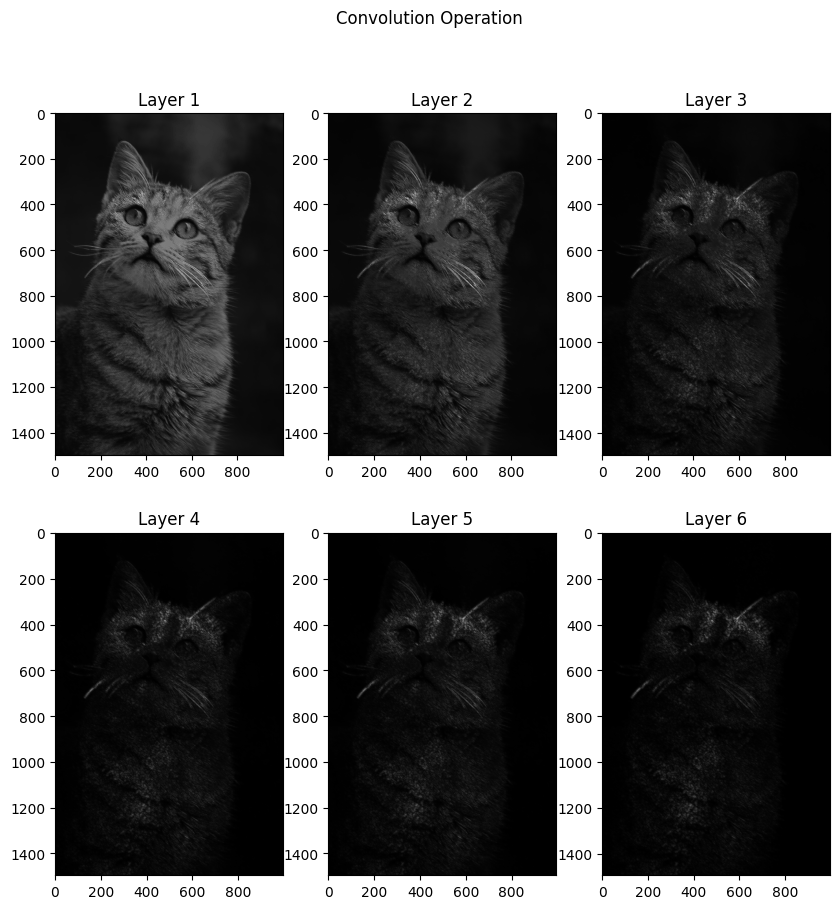

In [ ]:
import cv2
import plotly.express as ex
import torch
import torch.nn as nn
image=cv2.imread('/content/drive/MyDrive/PYTORCH_COURCERA/PYTORCH Basics/cat2.jpg',cv2.IMREAD_GRAYSCALE)
fig=ex.imshow(image,color_continuous_scale='gray',title='Original Image')

image=image.reshape(1,1,1500,1000)
image=torch.tensor(image,dtype=torch.float32)
conv=torch.nn.Sequential(nn.Conv2d(in_channels=1,out_channels=1,kernel_size=3,stride=1,padding=1),
                         nn.MaxPool2d(2,stride=1),
                         nn.ReLU())


print(conv.state_dict())
A=conv(image)
B=conv(A)
print(conv.state_dict())
C=conv(B)
print(conv.state_dict())
D=conv(C)
print(conv.state_dict())
E=conv(D)
print(conv.state_dict())


print(image.shape)

print(A.shape)
fig1=ex.imshow(A.squeeze().detach().numpy(),color_continuous_scale='gray')
fig2=ex.imshow(B.squeeze().detach().numpy(),color_continuous_scale='gray')
fig.update_layout(
    width=500,
    height=500
)

fig.show()
print()
print()
#fig1.show()
#fig2.show()


import matplotlib.pyplot as plt
plt.figure(figsize=(10,10))
plt.suptitle('Convolution Operation')
plt.subplot(2,3,1)
plt.title("Layer 1")
plt.imshow((A.squeeze().detach().numpy()),cmap='gray')

plt.subplot(2,3,2)
plt.title("Layer 2")
plt.imshow(B.squeeze().detach().numpy(),cmap='gray')

plt.subplot(2,3,3)
plt.title("Layer 3")
plt.imshow(C.squeeze().detach().numpy(),cmap='gray')

plt.subplot(2,3,4)
plt.title("Layer 4")
plt.imshow(D.squeeze().detach().numpy(),cmap='gray')

plt.subplot(2,3,5)
plt.title("Layer 5")
plt.imshow(D.squeeze().detach().numpy(),cmap='gray')

plt.subplot(2,3,6)
plt.title("Layer 6")
plt.imshow(E.squeeze().detach().numpy(),cmap='gray')


plt.show()


In [ ]:
conv1=nn.Conv2d(in_channels=1,out_channels=1,kernel_size=3,stride=1,padding=1)
conv1.state_dict()['weight'][0][0]=torch.tensor([[1, 0, -1],
                                                [2, 0, -2],
                                                 [1, 0, -1]],dtype=torch.float32)  # Sobel Filter
conv1.state_dict()['bias'][0]=torch.tensor([0.0])


max1=nn.MaxPool2d(2,stride=1)

image=cv2.imread('/content/drive/MyDrive/PYTORCH_COURCERA/PYTORCH Basics/cat2.jpg',cv2.IMREAD_GRAYSCALE)
fig=ex.imshow(image,color_continuous_scale='gray',title='Original Image')

image=image.reshape(1,1,1500,1000)
image=torch.tensor(image,dtype=torch.float32)
A=conv1(image)
A=max1(A)
A=torch.relu(A)

fig1=ex.imshow(A.squeeze().detach().numpy(),color_continuous_scale='gray')
fig1.show()
#######################################################

B=conv1(A)
B=max1(B)
B=torch.relu(B)

fig2=ex.imshow(B.squeeze().detach().numpy(),color_continuous_scale='gray')
fig2.show()

In [ ]:
# Multiple input channel and single output channel

import cv2
import torch
import torch.nn as nn
import plotly.express as ex
image=cv2.imread('/content/drive/MyDrive/PYTORCH_COURCERA/PYTORCH Basics/cat2.jpg')
print(f"shape of original image= {image.shape}")
h, w, c=image.shape[0],image.shape[1],image.shape[2]

image=image.reshape(1,c,h,w)

image= torch.tensor(image,dtype=torch.float32)
print(f"Reshaped image shape: {image.shape}")

conv=nn.Sequential(nn.Conv2d(in_channels=3, out_channels=1, kernel_size=3, stride=1, padding=1), nn.MaxPool2d(2,stride=2), nn.ReLU())

conv1=nn.Sequential(nn.Conv2d(in_channels=3, out_channels=5, kernel_size=3, stride=1, padding=1), nn.MaxPool2d(2,stride=2), nn.ReLU())
#print(f"conv.state_dict() = {conv.state_dict()}")

A=conv(image)
B=conv1(image)
print(A.shape)

fig1=ex.imshow(A.squeeze().detach().numpy(),color_continuous_scale='gray')
fig1.show()



shape of original image= (1500, 1000, 3)
Reshaped image shape: torch.Size([1, 3, 1500, 1000])
torch.Size([1, 1, 750, 500])


(750, 500, 5)


(-0.5, 499.5, 749.5, -0.5)

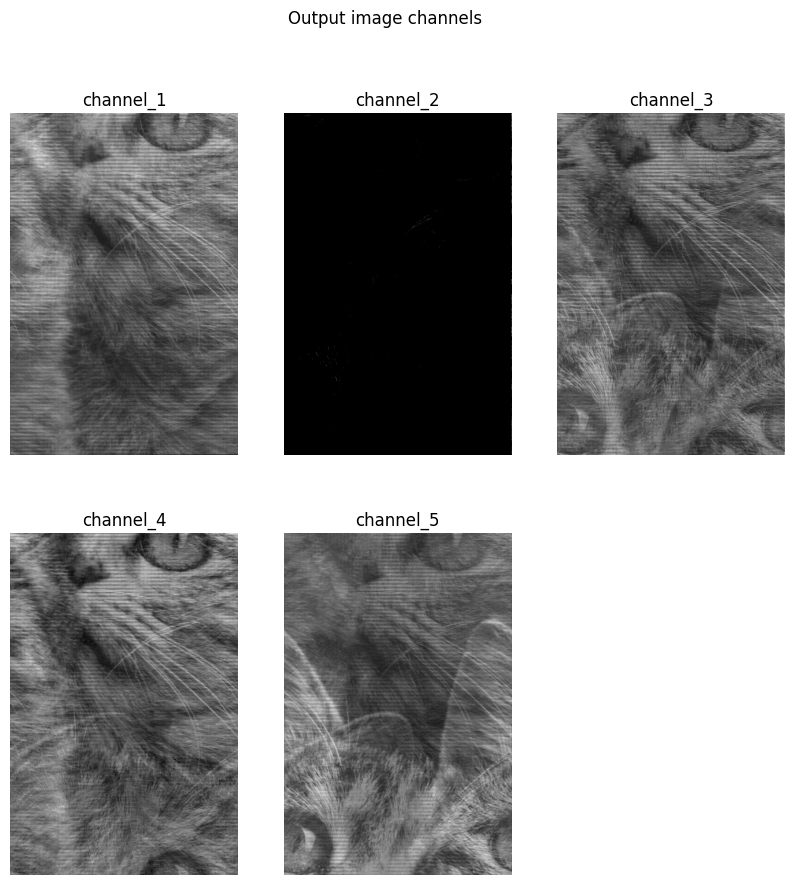

In [ ]:
import matplotlib.pyplot as plt

input_image_numpy = B.squeeze().detach().numpy().transpose(1,2,0);print(input_image_numpy.shape )

channel_1=input_image_numpy[:,:,0]
channel_2=input_image_numpy[:,:,1]
channel_3=input_image_numpy[:,:,2]
channel_4= input_image_numpy[:,:,3]
channel_5= input_image_numpy[:,:,4]

plt.figure(figsize=(10,10))
plt.suptitle("Output image channels")
plt.subplot(2,3,1)
plt.title('channel_1')
plt.imshow(channel_1,cmap='gray')
plt.axis('off')

plt.subplot(2,3,2)
plt.title('channel_2')
plt.imshow(channel_2,cmap='gray')
plt.axis('off')

plt.subplot(2,3,3)
plt.title('channel_3')
plt.imshow(channel_3,cmap='gray')
plt.axis('off')

plt.subplot(2,3,4)
plt.title('channel_4')
plt.imshow(channel_4,cmap='gray')
plt.axis('off')

plt.subplot(2,3,5)
plt.title('channel_5')
plt.imshow(channel_5,cmap='gray')
plt.axis('off')


